<a href="https://colab.research.google.com/github/jordan237prog/AWS-DEVOPS/blob/master/OCR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Steps

## 1. Upload dataset from drive and create function to plot images

## 2. Tessaract or EAST(OCR) to read the text

## 3. Detect Tire(Classifire Algorithm)
 this algorithm tells us if the image contains a tire or not
 if No classify the image with error
 if yes the image moves to the next algorithm 
## 4. Backgroud image remover Algorithm
 remove the background of the image
 get a clean image of the tire 
## 5. An algorithm to unwine the tire
  An algorithm to unwine the tire
  [image](https://www.google.com/url?sa=i&url=https%3A%2F%2Fblenderartists.org%2Ft%2Funwrapping-a-tire-keeping-scale%2F535159&psig=AOvVaw0FLIsbqrWZFnt1ooPIMxAK&ust=1640300713438000&source=images&cd=vfe&ved=0CAsQjRxqFwoTCPjJ1MTC-PQCFQAAAAAdAAAAABAJ)


# 1. Upload dataset from drive and create function to plot images

In [32]:
import cv2
import numpy as np
import glob
import matplotlib.pyplot as plt
import os
from google.colab.patches import cv2_imshow

In [2]:
# path = '/content/drive/MyDrive/Colab Notebooks/tireDataset'

# load and mount drive
from google.colab import drive
drive.mount('/content/gdrive')

# function to upload dataset from gdrive

def readImage(path):
  '''this function reads all images in a given path'''

  # load all images file names in an array
  files = os.listdir(path)

  # concatinating path with imagefile name to get the images relative paths
  images_path = [path + '/' +file for file in files]

  # uploading the images frome drive to the working env using cv2
  images = [cv2.imread(i, cv2.IMREAD_UNCHANGED) for i in images_path]
  return images


Mounted at /content/gdrive


In [3]:
path = './gdrive/MyDrive/Colab Notebooks/tireDataset'
images = readImage(path)

# for i in images:
#   plt.imshow(images[i])


In [4]:
len(images)

7

In [5]:
# ENTER A VALUE LESS THAN 10 IN CASE YOU HAVE A MASSIVE DATASET
# ploting all images,

def plot_image(img) -> None:
    """
    View multiple images stored in a list, stacking vertically

    Arguments:
        img: vector - image
    """
    plt.figure()
    plt.imshow(img)


def plot_images(imgs):
  num = int(input('Please enter the number of images you desire to plot: '))
  for x in range(num):
    plot_image(imgs[x]) 



Please enter the number of images you desire to plot: 1


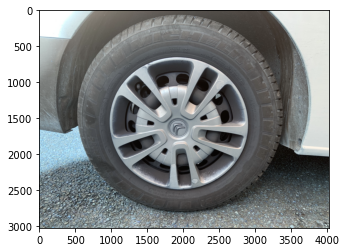

In [6]:
plot_images(images)


# OCR implimentation (Optical Character Recognition) using Tesseract OCR

steps to follow:

* Tesseract-ocr installation and test
* Preprocessing of the Image for OCR using OpenCV
* Text Localization
* Character Segmentation
* Character Recognition
* Post Processing





### Tesseract-ocr installation and test

In [25]:
# pytesseract installation
!sudo apt install tesseract-ocr
!pip install pytesseract

Reading package lists... Done
Building dependency tree       
Reading state information... Done
tesseract-ocr is already the newest version (4.00~git2288-10f4998a-2).
0 upgraded, 0 newly installed, 0 to remove and 37 not upgraded.


In [11]:
# import
import pytesseract

In [13]:
# OCR test on image[0], it returns text
custom_config = r'--oem 3 --psm 6'
pytesseract.image_to_string(images[0], config=custom_config)

'ee hh PS Be ran ss\n<li aes | A eee! Ee ee (ion f |” im qi\n2 er al | : —— TTT cerig ii str il 7 ,\n¢ Da a oie ek my TTT 2 ise PP ot ; .\nva Yh ee ne CT img i we .\nmae. UN ETC i Hh a ee Fen\neae aS SUNN Ee eae eT Illes TAT Dip ie ae — a\n= Wr ray CN \\ aah a i. eS a" (ier) | } WE Mi Ps Nag Pi\nee a ays a Nd ae | “qc = rates | fell Me Taig Pe »\nWN ea ‘\\geas|\\ Sam sre eA eT) yp PP *\nee uN K\\ cr - ee ae UTA ay 77; ee :\ny aia SS Lo \\ Se ™ _aseee Ba He / yy, ESS N N\nfs Fa A. ee Oo Sea ~— i I~ LS wa\n4 ea KW ae oe ey Se sa ] I ; Ns\n= DS a NS eg ai a ee a ell yj Me Wy d\nsf : y ae yA ‘ A p SS mn i: ype Mie ~ ‘\n. 7 ai PA a 4 ——s= itm a Pe, yD sa ps A:\nae KY ae Ro Le Dn Dip —~ Yi, LO tN\ney a Fit ye S / iy SA ee, Uy pS A\n‘. re. —S ay ; y Vi yy ie ; S Ye As ee a il & Se Hj. Cs Ys 4 Les *\nEee ea F a\'s i Li SS Vie , i ; y Cay § x ae ne\nae oe : pitts Ae < 5 é , 2 a a\nJaa aia tes i 4 ee his ied ye aha y ‘ FD Ye a Maeehes\neee ita ! a c / Xe. Ze [aes peer\neee : Ps i Soi é / j SS Zo

### Preprocessing of the Image for OCR using OpenCV

In [37]:


# get grayscale image
def get_grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# noise removal
def remove_noise(image):
    return cv2.medianBlur(image,5)
 
#thresholding
def thresholding(image):
    return cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]

#dilation
def dilate(image):
    kernel = np.ones((5,5),np.uint8)
    return cv2.dilate(image, kernel, iterations = 1)
    
#erosion
def erode(image):
    kernel = np.ones((5,5),np.uint8)
    return cv2.erode(image, kernel, iterations = 1)

#opening - erosion followed by dilation
def opening(image):
    kernel = np.ones((5,5),np.uint8)
    return cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)

#canny edge detection
def canny(image):
    return cv2.Canny(image, 100, 200)

#skew correction
def deskew(image):
    coords = np.column_stack(np.where(image > 0))
    angle = cv2.minAreaRect(coords)[-1]
    if angle < -45:
        angle = -(90 + angle)
    else:
      angle = -angle
    (h, w) = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    rotated = cv2.warpAffine(image, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return rotated

#template matching
def match_template(image, template):
    return cv2.matchTemplate(image, template, cv2.TM_CCOEFF_NORMED)

In [38]:
image = images[0]

gray = get_grayscale(image)
thresh = thresholding(gray)
opening = opening(gray)
canny = canny(gray)

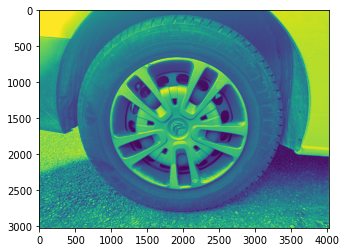

In [43]:
plt.imshow(gray)

In [26]:
pytesseract.image_to_string(gray, config=custom_config)

'eels aia\nG y\n- 8 4S ee\ncs ie ey aI Pe ps a ei: hee os\ney 2 2 og 1) Maen / 2 a o-\nPy re ‘ iy A fete 3 £ - 5 & ye oe MS | 7 we *\n: Pl!) Ulu x\nin. y\\ On i va LS sm nn MT My) Fim ee een b\nef 7 ac A EY lh a OE eT A PT nae Ma ew “> ~~ .\n. 4 mae NM NAN re eee BB ll ees cc aM Vien: oe %\n— he Ce al ‘aa 7 . crm i | ey (oT My Me By ey oe a\n4 y 2M QUI Aa ee \\ E [sere Penna} Philly FY si el Hla 3s\nie ye ; \\< os \\ a 2 Oh ee ee i Bre NO 4 Ln 7), > F han A\n(re CA j ee ; Uli we Mf i Map B 5\nFa ( La ZUStsSS eas ’ if YY ; j , : be\nSe ; y ea QW aN S Sa ieee Unis FE sp LY ON A x A\nne iia av os “2 teats NN vo ea — : ar Yi ey rm . 8,\n=z Pe Weg ; 20 came We Sas. Wy 7S oN\nPA ae Kk a ? cea oe 9 1 aes E Vig i WIA 3 Satna: \\\nes ; yi Fe) i wae esa en Ha is. Uj Lily < " non\n7. “A Li ee : Sy CN wk\noo Bice AS Sa Pa Ad DA a : NS Lipp eC Ya ; Bb he\n= | ; ea i ee “ i S < Y i ‘ ye Ye LS ~ aia e)\n_ oe ae ; | ee ie vA A , 3 Z Gp), SF ee eee\ni Se x ay : J Z | Vanes\nSe ‘ So ae nde ery Ze 4 J ) 

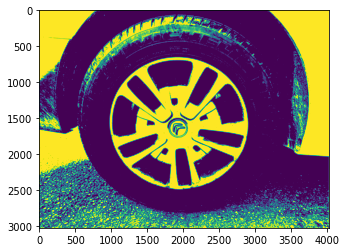

In [42]:
plt.imshow(thresh)

In [24]:
pytesseract.image_to_string(thresh, config=custom_config)

'Be PO.\nee i\nee een” Fos ee >\nran are ial i Q cs aT. ete 7.\nsey: L ¢ af vet Mf So 2 =.’ =. a\nSa HE . E -f peo re f . 1 & ‘ye i moar ee -\n| Py, !)6 UU! U2 a\nBt yi ita oe ro Na i nl i iis ee ee a\na 7 ile (is ele eee Bee HET sent i ee te ~ °\n. 4 (omc A eee ae S | Pn ria ies: i ewe \\\n. we . (2s “sath ae \\ F eu i | as, (or Me Me: ae an a\nJ ra M eC NaN lll r i ies Peete ey i YY SS og .\nPs yO . K« a a ee ; aes lft Ce i a .\nPes Cah RN F ee , an re SRG Mae rae b> ;\nPSM (AY ee oe ZOLIEE Tee s We. a : ; : ; Ss\na : ye a: OE ae - a as nr, ae eT. fa rn . AS\n_ jee oe oN a eee ain , oe are a ae p -&,\nz yr. kee a , a ae re ips a? oN Som \\.\nPA a A ae y cn we ; ae ~, ; re aa 2 , ares\n. z , ae we aa _ oa we a. re? 4 , on\nY os a on ee | ara oo one\nee RR OOR a wa a ti , an cn ae ; aa cee eee\n_ ae ; ee aS 2 > i. 7 a - ; oa oan 7 a AF me\neae ; | e Se th a ; ; 5 i ees:\n; een 7 oe" (A/a s g oe hoe fo ACCES\nae : Bo, Figs ae va : ; / : ; as ars 4 a are BS t\nSecret or a j Pi a oe Me ee

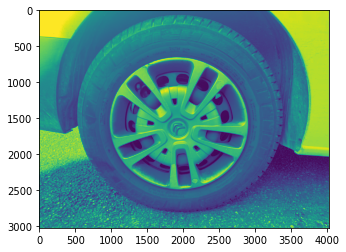

In [41]:
plt.imshow(opening)

In [23]:
pytesseract.image_to_string(opening, config=custom_config)

'Z\nP i ‘ a : “ _— ta? F ae pee 7\nin BS ee Ce eee Le\nroa \\ 4 ora foe j Pai — r = ay . “i\nTf <a SD / .\noY, ae , <i zi SSNS, e “s\nye iF a ¢ Fl ™ \\\n: - ye. i A , \\\npS ay : has i dl bi\nho ae 7\na PX A Hd “Tf : - =\neal y : 4 Aas\neH Fs { ry y z a\n: e Ca / | i: L\nLd 4 4 ry i\na > } ae 1\ngets 2 my\n: E q \\ th 1\n\\ j hag\nMie ss > U ; Ae ‘\nni — : ’ ; . L LOE ;\nad a , Bah teest -\nwee ade\nao a ‘ ae\nwo : : % + ;\npo — _ Rhy ae\nSe ! ) , : ae\nm5 : te Ty\n: : ‘ : ‘ ar\na r ‘ : —_, He 5\nead Pitas Fs re | i\n; | (rt Tee.\n: |. oe gaa eeu ed = r\n; A PERE I ARDS A ka og F\nEZ a CA AN SE OP, Sat fie ,\na Lage FP este pS, phe “ra Soh i : =\nape hoote AE RE hee, i .,\nFite Ohi gC D gee = Z\nete SEAN IS AS ite OO a z Se ee\nFLD oh PS BET | Fae 4 i: em ea Lor ~ — = ns q\ni PE SDN ie aE ie eR ERS eae eS\n2 i v2 ad "2g 7s z se A Pe fT; a ee x ae a : : Rens ‘ 4 a\nDiy EID SS SOY Nott) PRR ag tee ee\nPoel ET, JR PSI A SS IES Yn Mee Se Fra I hate ee\n, pe BLP END Me OPE SA eae PUP Ad het

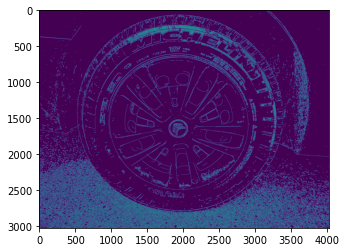

In [21]:
plt.imshow(canny)

In [22]:
pytesseract.image_to_string(canny, config=custom_config)

'7 PRA,\nN “S\n4 ae\n== %,\n: ETT LOR FS Io Foe. ay\n; It, a iw re os ate va mm — , .\nSe a {Po ey h ye ™ d Va as a ,\naf IP ee ee oa a. oe\nmeee a i ar WA ae ease Ne\nnl ul ee, eee cl eka A i co oh, . meres a en =\n; ° ie y t i ee oe et = fi [3g 4 a } oy " i ae G. Va a Tan ; a\né . eR ean uu Z i é Le ae) re ws A - ~~ 5\n\\ ae ———s, io. = ii a A — aaa. AN & >\n. Ae sis nea ri 1 a . Vie: ‘e\nWee 35 ee Ee | rs. i. UN :\n, ce sig Ro Fy Sa a Ae ;\nG a { \\ ee: » aN) yi s wy ee a y add Re mee oN y aN\nnes Ao Gee oy : pee . ~~ a y Via LOS VA mS\nee ane 7 Cre 4 a 7 as ce - yh ane Ds anes ‘ oe\n. 8 a ‘ha a ye oa J an Pet) : i Shy ¢ as oN . : oe\n| | aS en i tease “ee?” "MS Se\n: .* aan fs aw a : a Pra nice’ hy ae a vr ON “ ae oN : Be us\nA 4 aN a“ ds ee a hg tee _~ ME ON we \' oie,\nos ‘aA as an ee oe te aia “a NS a ar ; ce iS ;\n_ ; Me \\ y CS. ra a) \\ a 8 —— ae Cs mo A e ‘ oo ae a a ee A a\nre {| a va eee ig LO ae aN PO Na a er\naa fi My an ; ate ae Me SS Ce rma i oe ae EN os\n: es . Ve i y

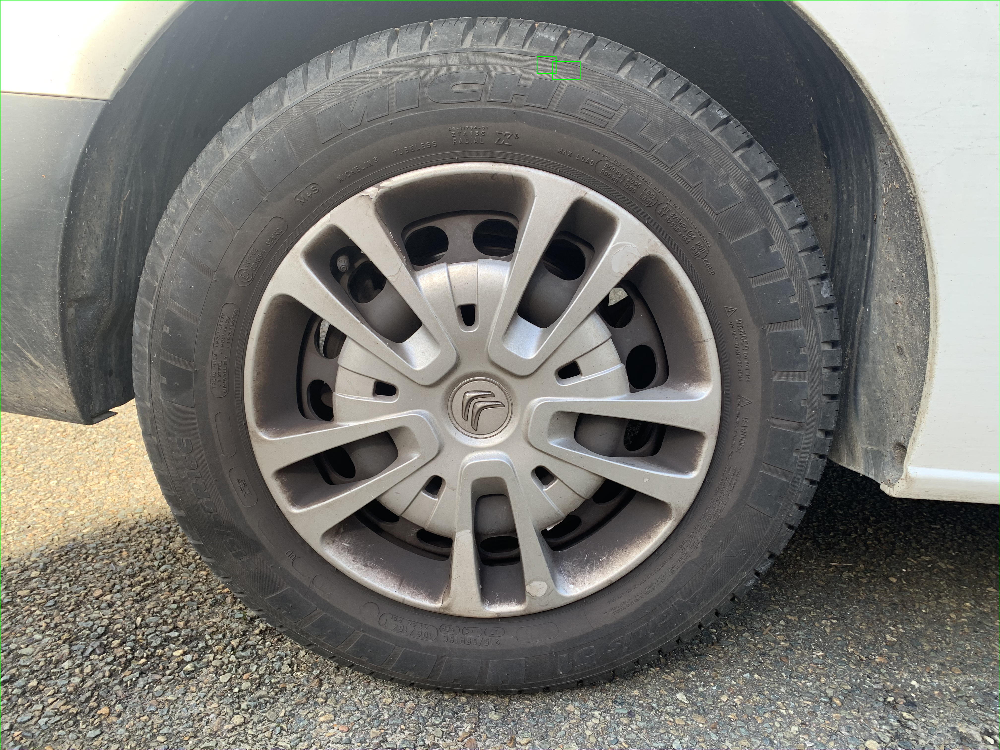

-1

In [31]:
from google.colab.patches import cv2_imshow

h, w, c = image.shape
boxes = pytesseract.image_to_boxes(image) 
for b in boxes.splitlines():
    b = b.split(' ')
    image = cv2.rectangle(image, (int(b[1]), h - int(b[2])), (int(b[3]), h - int(b[4])), (0, 255, 0), 2)

# plt.imshow(image)
cv2_imshow(image)
cv2.waitKey(0)

In [45]:
from pytesseract import Output

d = pytesseract.image_to_data(image, output_type=Output.DICT)
print(d.keys())

dict_keys(['level', 'page_num', 'block_num', 'par_num', 'line_num', 'word_num', 'left', 'top', 'width', 'height', 'conf', 'text'])


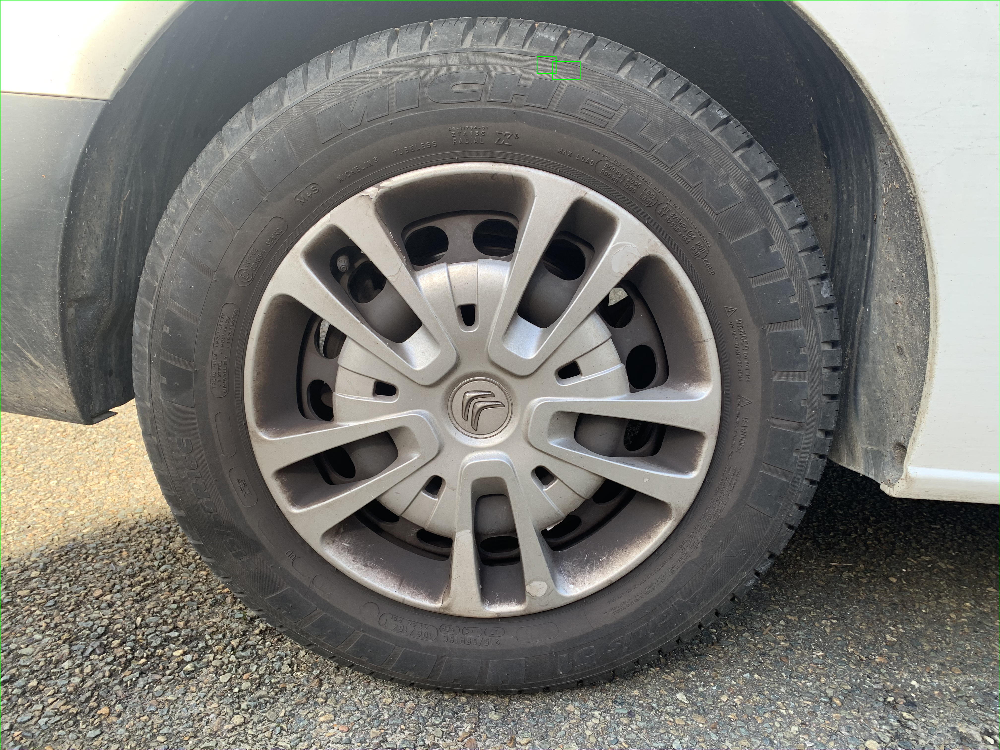

-1

In [47]:
n_boxes = len(d['text'])
for i in range(n_boxes):
    if int(d['conf'][i]) > 60:
        (x, y, w, h) = (d['left'][i], d['top'][i], d['width'][i], d['height'][i])
        img = cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)

cv2_imshow(img)
cv2.waitKey(0)

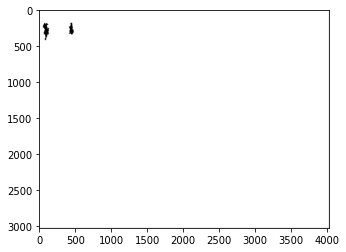

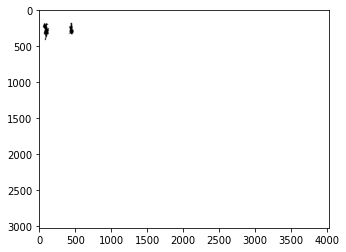

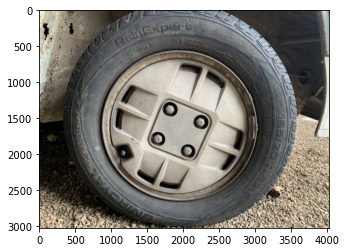

In [17]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image
# img = cv2.imread(images[0], 3)
img = images[2]

# Create a blank image of zeros(same dimension as img)
# It should be grayscale(1 color channel)
marker = np.zeros_like(img[: ,: , 0]).astype(np.int32)

# This step is manual.The goal is to find the points
# which create the result we want.I suggest using a
# tool to get the pixel coordinates.

# Dictate the background and set the markers to 1
marker[204][95] = 1
marker[240][137] = 1
marker[245][444] = 1
marker[260][427] = 1
# marker[257][378] = 1
# marker[217][466] = 1

# Dictate the area of interest
# I used different values
# for each part of the car(for visibility)

# marker[235][370] = 255 # car body
# marker[135][294] = 64 # rooftop
# marker[190][454] = 64 # rear light
# marker[167][458] = 64 # rear wing
# marker[205][103] = 128 # front bumper

# rear bumper
# marker[225][456] = 128
# marker[224][461] = 128
# marker[216][461] = 128

# front wheel
# marker[225][189] = 192
# marker[240][147] = 192

# rear wheel
marker[258][409] = 192
marker[257][391] = 192
marker[254][421] = 192

# Now we have set the markers, we use the watershed
# algorithm to generate a marked image
marked = cv2.watershed(img, marker)

# Plot this one.If it does what we want, proceed;
# otherwise edit your markers and repeat
plt.imshow(marked, cmap = 'gray')
plt.show()

# Make the background black, and what we want to keep white
marked[marked == 1] = 0
marked[marked > 1] = 255

# Use a kernel to dilate the image, to not lose any detail on the outline
# I used a kernel of 3 x3 pixels
kernel = np.ones((3, 3), np.uint8)
dilation = cv2.dilate(marked.astype(np.float32), kernel, iterations = 1)

# Plot again to check whether the dilation is according to our needs
# If not, repeat by using a smaller / bigger kernel, or more / less iterations
plt.imshow(dilation, cmap = 'gray')
plt.show()

# Now apply the mask we created on the initial image
final_img = cv2.bitwise_and(img, img, mask = dilation.astype(np.uint8))

# cv2.imread reads the image as BGR, but matplotlib uses RGB
# BGR to RGB so we can plot the image with accurate colors
b, g, r = cv2.split(final_img)
final_img = cv2.merge([r, g, b])

# Plot the final result
plt.imshow(final_img)
plt.show()